# Magway ERW Sites Survey

In this notebook, we'll step into the shoes of a humanitarian demining organisation working in Myanmar. We'll aim to conduct a preliminary survey of potential ERW sites in Magway, a region previously free of conflict, by mapping possible ERW sites (or at least the scale of contamination in each township) using the ACLED dataset. 

Then we'll go a step further and categorise the land use category of each site (i.e. farmland, school, temple, etc.) to get a sense of where the explosions happened and why they were targeted.

In [2]:
# Import data processing libaries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Import statsmodels' ols function to initialise simple linear regression model
import statsmodels.formula.api as smf

# Import (multiple) linear regressional kit from scikit-learn
from sklearn.linear_model import LinearRegression

In [3]:
# read in the dataset
magwaydf = pd.read_csv('magway_explosive_events.csv')

# setting the display option so we can see all the columns
pd.set_option('display.max_columns', None)

# display dataframe
magwaydf.head(5)

,event_id,event_date,year,time_precision,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,interaction,region,country,admin1,admin2,admin3,location,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,timestamp
0,32957,2022-04-15,2022,1,Explosions/Remote violence,Shelling/artillery/missile attack,People's Defense Force - Myaing,Young Force-UG; Earthquake People's Defense Fo...,3,Military Forces of Myanmar (2021-),NaN,1,13,Southeast Asia,Myanmar,Magway,Pakokku,Pakokku,Pakokku,21.3349,95.0844,1,Democratic Voice of Burma,National,"On 15 April 2022, in Pakokku town (Pakokku tow...",5,1650379020
1,32922,2022-04-13,2022,1,Explosions/Remote violence,Remote explosive/landmine/IED,People's Defense Force - Yesagyo,NaN,3,Military Forces of Myanmar (2021-),NaN,1,13,Southeast Asia,Myanmar,Magway,Pakokku,Yesagyo,Gwet Gyi,21.4826,95.2405,2,Democratic Voice of Burma,National,"On 13 April 2022, between Gwet Gyi and Ah Lel ...",0,1650379020
2,32872,2022-04-12,2022,1,Explosions/Remote violence,Grenade,PKU N PDF: Pakokku North PDF,King Cobra-Khin U; Southern YSO PDF: Southern ...,3,Military Forces of Myanmar (2021-),NaN,1,13,Southeast Asia,Myanmar,Magway,Pakokku,Pakokku,Pakokku,21.3349,95.0844,1,Democratic Voice of Burma,National,"On 12 April 2022, in Pakokku town (Pakokku dis...",0,1650379020
3,32807,2022-04-11,2022,1,Explosions/Remote violence,Remote explosive/landmine/IED,Pyu Saw Htee,NaN,3,Civilians (Myanmar),NaN,7,37,Southeast Asia,Myanmar,Magway,Pakokku,Seikphyu,Shar Hla,21.2024,94.3774,1,Shwe Phee Myay News Agency,National,"On 11 April 2022, in Shar Hla village, Seikphy...",1,1650379021
4,32749,2022-04-10,2022,1,Explosions/Remote violence,Remote explosive/landmine/IED,People's Defense Force - Myaing,NaN,3,Military Forces of Myanmar (2021-),NaN,1,13,Southeast Asia,Myanmar,Magway,Pakokku,Myaing,Myaing,21.6125,94.8543,2,Shwe Phee Myay News Agency; Ministry of Defens...,National,"On 10 April 2022, in Myaing township (Pakokku ...",1,1650379020


In [4]:
# quick data cleaning - casting the event_date column as a datetimeobject
magwaydf['event_date'] = pd.to_datetime(magwaydf['event_date'])

# checking that we have the right datatypes
magwaydf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399 entries, 0 to 398
Data columns (total 27 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   event_id        399 non-null    int64         
 1   event_date      399 non-null    datetime64[ns]
 2   year            399 non-null    int64         
 3   time_precision  399 non-null    int64         
 4   event_type      399 non-null    object        
 5   sub_event_type  399 non-null    object        
 6   actor1          399 non-null    object        
 7   assoc_actor_1   56 non-null     object        
 8   inter1          399 non-null    int64         
 9   actor2          244 non-null    object        
 10  assoc_actor_2   36 non-null     object        
 11  inter2          399 non-null    int64         
 12  interaction     399 non-null    int64         
 13  region          399 non-null    object        
 14  country         399 non-null    object        
 15  admin1

### Map of Contaminated Townships

To map the first level of contamination, we need a dataframe of incidents by township. At this stage, we are not interested in identifying the scale of contamination (i.e. how many mines were planted, how many artillery shells were shot). We want to first identify the townships that have seen the most explosive incidents.

In [5]:
# displaying the dataframe to check which columns to remove
# with pd.option_context('display.max_colwidth', -1):
#     display(magwaydf)

# we should remove: 'year', 'time_precision', 'event_type', 'assoc_actor_1', 'inter1', 'assoc_actor_2', 'inter2', 'interaction', 'region', 'country', 'geo_precision', 'source', 'source_scale', 'timestamp' 
incidentsdf = magwaydf.drop(columns=['year', 'time_precision', 'event_type', 'assoc_actor_1', 'inter1', 'assoc_actor_2', 'inter2', 'interaction', 'region', 'country', 'geo_precision', 'source', 'source_scale', 'timestamp'])
incidentsdf.head(3)

,event_id,event_date,sub_event_type,actor1,actor2,admin1,admin2,admin3,location,latitude,longitude,notes,fatalities
0,32957,2022-04-15,Shelling/artillery/missile attack,People's Defense Force - Myaing,Military Forces of Myanmar (2021-),Magway,Pakokku,Pakokku,Pakokku,21.3349,95.0844,"On 15 April 2022, in Pakokku town (Pakokku tow...",5
1,32922,2022-04-13,Remote explosive/landmine/IED,People's Defense Force - Yesagyo,Military Forces of Myanmar (2021-),Magway,Pakokku,Yesagyo,Gwet Gyi,21.4826,95.2405,"On 13 April 2022, between Gwet Gyi and Ah Lel ...",0
2,32872,2022-04-12,Grenade,PKU N PDF: Pakokku North PDF,Military Forces of Myanmar (2021-),Magway,Pakokku,Pakokku,Pakokku,21.3349,95.0844,"On 12 April 2022, in Pakokku town (Pakokku dis...",0


<AxesSubplot:>

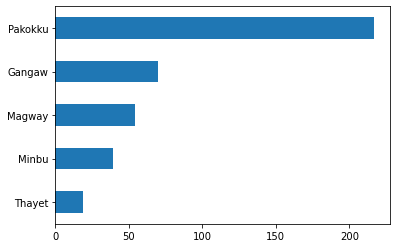

In [6]:
# a quick plot to see distribution of incidents by township
incidentsdf['admin2'].value_counts(ascending=True).plot(kind='barh')

# There are only 5 townships in Magway. It looks like we have to go to the ward level 'admin3' to get a more detailed picture of the distribution of explosive events
# I really didn't expect Pakokku to have the most number of explosive incidents

In [7]:
# now let's create the contamination map using Folium
# we'll map explosive events by township

# import folium
import folium
from folium import plugins

# import the geojson file
import json
json_file_path = 'myanmartownships.geojson'

# reading in the geojson file
with open(json_file_path, 'r', encoding='utf8') as j: # open the json file and assign it to a variable
    townships_geo = json.loads(j.read()) # load the read j json dictionary
    
# https://www.freecodecamp.org/news/python-parse-json-how-to-read-a-json-file/

In [34]:
# checking to see that the townships_geo file has loaded properly
townships_geo['features'][0]['geometry']['coordinates'][0][:10]

[[96.15952987500003, 26.117981096000012],
 [96.16071960600006, 26.120063124000062],
 [96.158340143, 26.121252855],
 [96.15909735400004, 26.12458983400006],
 [96.16260668400005, 26.125307255000088],
 [96.16456610000009, 26.12420508200002],
 [96.16579073800007, 26.12322537400005],
 [96.16400011700007, 26.120808039000057],
 [96.16626567300003, 26.119470014000104],
 [96.17105247100005, 26.119073575000076]]

In [11]:
# Exploring our geojson file

# Layer 1
[key for key in townships_geo]

# Layer 2 under Layer 1 - 'features'
[key for key in townships_geo['features'][0]]

# Layer 3 under Layer 2 - 'geometry'
[key for key in townships_geo['features'][0]['properties']]

# we need to add tooltip data to 'properties'

# https://www.geeksforgeeks.org/read-json-file-using-python/#:~:text=Reading%20From%20JSON,to%20read%20the%20JSON%20file.

['OBJECTID',
 'ST',
 'ST_PCODE',
 'DT',
 'DT_PCODE',
 'TS',
 'TS_PCODE',
 'ST_2',
 'LABEL2',
 'SELF_ADMIN',
 'ST_RG',
 'T_NAME_WIN',
 'T_NAME_M3',
 'AREA']

In [12]:
townships_geo

# checking the keys
townships_geo.keys()

# transform the geojson dictionary into a dataframe
# pd.DataFrame.from_dict(townships_geo['features'])['properties'].loc[0]

# transforms the json dictionary into a dataframe
township_coordinates = pd.json_normalize(townships_geo['features'], sep='_')
township_coordinates

# selecting only Magway townships
magway_township_cood = township_coordinates.loc[township_coordinates['properties_ST'] == 'Magway']
# cleaning up the Magway townships geojson df to get only the columns we need
magway_township_cood = magway_township_cood[['type', 'properties_OBJECTID', 'properties_ST', 'properties_DT', 'properties_TS', 'properties_ST_2', 'properties_AREA', 'geometry_type', 'geometry_coordinates']]
magway_township_cood.head(5)

,type,properties_OBJECTID,properties_ST,properties_DT,properties_TS,properties_ST_2,properties_AREA,geometry_type,geometry_coordinates
11,Feature,29.0,Magway,Thayet,Kamma,Magway Region,1148.809299,Polygon,"[[[94.69719484700003, 18.95979479400005], [94...."
26,Feature,149.0,Magway,Thayet,Mindon,Magway Region,2558.545143,Polygon,"[[[94.88464459800007, 19.560394306000028], [94..."
39,Feature,193.0,Magway,Thayet,Aunglan,Magway Region,2682.703092,Polygon,"[[[95.16377174100002, 19.48165364400005], [95...."
166,Feature,107.0,Magway,Magway,Natmauk,Magway Region,2314.273659,Polygon,"[[[95.5985240200001, 20.69849090500002], [95.5..."
170,Feature,50.0,Magway,Pakokku,Myaing,Magway Region,2041.567155,Polygon,"[[[94.87272031400003, 21.85852620600006], [94...."


In [13]:
# rename the columns so they're more readable
magway_township_cood.rename(columns={'properties_OBJECTID': 'OBJECTID',
                                     'properties_ST': 'state',
                                     'properties_DT': 'district',
                                     'properties_TS': 'township',
                                     'properties_ST_2': 'region',
                                     }, inplace=True)

magway_township_cood

,type,OBJECTID,state,district,township,region,properties_AREA,geometry_type,geometry_coordinates
11,Feature,29.0,Magway,Thayet,Kamma,Magway Region,1148.809299,Polygon,"[[[94.69719484700003, 18.95979479400005], [94...."
26,Feature,149.0,Magway,Thayet,Mindon,Magway Region,2558.545143,Polygon,"[[[94.88464459800007, 19.560394306000028], [94..."
39,Feature,193.0,Magway,Thayet,Aunglan,Magway Region,2682.703092,Polygon,"[[[95.16377174100002, 19.48165364400005], [95...."
166,Feature,107.0,Magway,Magway,Natmauk,Magway Region,2314.273659,Polygon,"[[[95.5985240200001, 20.69849090500002], [95.5..."
170,Feature,50.0,Magway,Pakokku,Myaing,Magway Region,2041.567155,Polygon,"[[[94.87272031400003, 21.85852620600006], [94...."
181,Feature,239.0,Magway,Minbu,Sidoktaya,Magway Region,2830.454355,Polygon,"[[[94.2462136340001, 20.834692516000096], [94...."
203,Feature,102.0,Magway,Thayet,Thayet,Magway Region,1206.113934,Polygon,"[[[95.01985117400005, 19.580209281000037], [95..."
204,Feature,206.0,Magway,Gangaw,Saw,Magway Region,1784.787627,Polygon,"[[[94.28739056000005, 21.490619824000067], [94..."
212,Feature,251.0,Magway,Thayet,Minhla,Magway Region,2383.175707,Polygon,"[[[95.00744314500005, 19.999633919000036], [95..."
220,Feature,34.0,Magway,Magway,Myothit,Magway Region,1596.372232,Polygon,"[[[95.29669141100007, 20.27897406300012], [95...."


In [14]:
# downloading the table of Magway townships so I can add the central coordinates manually

magway_townships = magway_township_cood[['state', 'district', 'township']]

# adding empty columns for latitude and longitude
magway_townships = magway_townships.reindex(columns=list(['state', 'district', 'township', 'latitude', 'longitude']))

# https://stackoverflow.com/questions/30926670/add-multiple-empty-columns-to-pandas-dataframe

# manually adding the coordinates
# magway_townships.loc[magway_townships['township'] == 'Kamma'].replace({'latitude': {np.nan: 19.0243}, 'longitude': {np.nan: 95.0976}}, inplace=True)
# magway_townships.loc[magway_townships['township'] == 'Kamma', 'latitude']
magway_townships.loc[magway_townships['township'] == 'Kamma', ['latitude', 'longitude']] = [19.0243, 95.0976]
magway_townships.loc[magway_townships['township'] == 'Mindon', ['latitude', 'longitude']] = [19.4143, 94.6450]
magway_townships.loc[magway_townships['township'] == 'Aunglan', ['latitude', 'longitude']] = [19.3603, 95.2188]
magway_townships.loc[magway_townships['township'] == 'Natmauk', ['latitude', 'longitude']] = [20.3520, 95.3966]
magway_townships.loc[magway_townships['township'] == 'Myaing', ['latitude', 'longitude']] = [21.6105, 94.8495]
magway_townships.loc[magway_townships['township'] == 'Sidoktaya', ['latitude', 'longitude']] = [20.4487, 94.2466]
magway_townships.loc[magway_townships['township'] == 'Thayet', ['latitude', 'longitude']] = [19.3228, 95.1797]
magway_townships.loc[magway_townships['township'] == 'Saw', ['latitude', 'longitude']] = [21.1532, 94.1539]
magway_townships.loc[magway_townships['township'] == 'Minhla', ['latitude', 'longitude']] = [19.9684, 95.0130]
magway_townships.loc[magway_townships['township'] == 'Myothit', ['latitude', 'longitude']] = [20.2006, 95.4450]
magway_townships.loc[magway_townships['township'] == 'Sinbaungwe', ['latitude', 'longitude']] = [19.7223, 95.1628]
magway_townships.loc[magway_townships['township'] == 'Yenangyaung', ['latitude', 'longitude']] = [20.4593, 94.8780]
magway_townships.loc[magway_townships['township'] == 'Taungdwingyi', ['latitude', 'longitude']] = [20.0001, 95.5460]
magway_townships.loc[magway_townships['township'] == 'Magway', ['latitude', 'longitude']] = [20.07, 95.08] # 20.117/95.133
magway_townships.loc[magway_townships['township'] == 'Ngape', ['latitude', 'longitude']] = [20.0765, 94.4684]
magway_townships.loc[magway_townships['township'] == 'Pauk', ['latitude', 'longitude']] = [21.4542, 94.4826]
magway_townships.loc[magway_townships['township'] == 'Yesagyo', ['latitude', 'longitude']] = [21.6164, 95.2449]
magway_townships.loc[magway_townships['township'] == 'Seikphyu', ['latitude', 'longitude']] = [20.9047, 94.7873]
magway_townships.loc[magway_townships['township'] == 'Gangaw', ['latitude', 'longitude']] = [22.1757, 94.1347]
magway_townships.loc[magway_townships['township'] == 'Salin', ['latitude', 'longitude']] = [20.5725, 94.6502]
magway_townships.loc[magway_townships['township'] == 'Minbu', ['latitude', 'longitude']] = [20.1714, 94.8702]
magway_townships.loc[magway_townships['township'] == 'Pakokku', ['latitude', 'longitude']] = [21.3394, 95.0703]
magway_townships.loc[magway_townships['township'] == 'Tilin', ['latitude', 'longitude']] = [21.6961, 94.0977]
magway_townships.loc[magway_townships['township'] == 'Pwintbyu', ['latitude', 'longitude']] = [20.3728, 94.6735]
magway_townships.loc[magway_townships['township'] == 'Chauk', ['latitude', 'longitude']] = [20.9006, 94.8261]

# show the resulting dataframe
magway_townships

,state,district,township,latitude,longitude
11,Magway,Thayet,Kamma,19.0243,95.0976
26,Magway,Thayet,Mindon,19.4143,94.6450
39,Magway,Thayet,Aunglan,19.3603,95.2188
166,Magway,Magway,Natmauk,20.3520,95.3966
170,Magway,Pakokku,Myaing,21.6105,94.8495
181,Magway,Minbu,Sidoktaya,20.4487,94.2466
203,Magway,Thayet,Thayet,19.3228,95.1797
204,Magway,Gangaw,Saw,21.1532,94.1539
212,Magway,Thayet,Minhla,19.9684,95.0130
220,Magway,Magway,Myothit,20.2006,95.4450


### Map 1 - Concentration of EXO Events in Magway

In [15]:
# rename the state, district, and township columns
incidentsdf.rename(columns={'admin1': 'state',
                            'admin2': 'district',
                            'admin3': 'township'},
                            inplace=True)

In [16]:
# let's create an aggregated df of total number of EXO incidents and total number of fatalities
agg_incidentsdf = incidentsdf.groupby(['township', 'sub_event_type'], as_index=False).agg(
                                        total_events = pd.NamedAgg(column='event_id', aggfunc='count'),
                                        total_fatalities = pd.NamedAgg(column='fatalities', aggfunc='sum'))



# then let's merge it with the coordinates dataframe
agg_incidentsdf = agg_incidentsdf.merge(magway_townships)

# a bit of data cleaning
agg_incidentsdf.drop(columns=['state'], inplace=True)

first_col = agg_incidentsdf.pop('district')
agg_incidentsdf.insert(0, 'district', first_col)

third_col = agg_incidentsdf.pop('latitude')
agg_incidentsdf.insert(2, 'latitude', third_col)

fourth_col = agg_incidentsdf.pop('longitude')
agg_incidentsdf.insert(3, 'longitude', fourth_col)

agg_incidentsdf

,district,township,latitude,longitude,sub_event_type,total_events,total_fatalities
0,Thayet,Aunglan,19.3603,95.2188,Remote explosive/landmine/IED,1,0
1,Magway,Chauk,20.9006,94.8261,Remote explosive/landmine/IED,2,0
2,Gangaw,Gangaw,22.1757,94.1347,Air/drone strike,1,9
3,Gangaw,Gangaw,22.1757,94.1347,Remote explosive/landmine/IED,32,188
4,Gangaw,Gangaw,22.1757,94.1347,Shelling/artillery/missile attack,12,18
5,Thayet,Kamma,19.0243,95.0976,Remote explosive/landmine/IED,9,0
6,Thayet,Kamma,19.0243,95.0976,Shelling/artillery/missile attack,1,0
7,Magway,Magway,20.0700,95.0800,Grenade,2,0
8,Magway,Magway,20.0700,95.0800,Remote explosive/landmine/IED,18,22
9,Magway,Magway,20.0700,95.0800,Shelling/artillery/missile attack,1,0


In [17]:
# let's try to map these events

# first, create the base map
world_map = folium.Map(location=[21,95], zoom_start=7)
world_map

# total events layer
folium.Choropleth(
    # Include the geojson file here
    geo_data=townships_geo,
    data=agg_incidentsdf,
    columns=['township', 'total_events'],
    key_on='feature.properties.TS',
    bins=6,
    nan_fill_color='grey',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Explosive Incidents in Magway State Townships',
    highlight=True,
    name='Total Events',
    show=False
).add_to(world_map)

# total fatalities layer
folium.Choropleth(
    # Include the geojson file here
    geo_data=townships_geo,
    data=agg_incidentsdf,
    columns=['township', 'total_fatalities'],
    key_on='feature.properties.TS',
    bins=6,
    nan_fill_color='grey',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Explosive Incident Fatalities in Magway State Townships',
    highlight=True,
    name='Total Fatalities',
    show=False
).add_to(world_map)

# add pop-up text to each marker on the map
latitudes1 = list(agg_incidentsdf['latitude']) # need to find the coordinates for each township
longitudes1 = list(agg_incidentsdf['longitude'])
labels1 = list(agg_incidentsdf['township'])
count_events = list(agg_incidentsdf['total_events'])
# count_fatalities = list(agg_incidentsdf['total_fatalities']) # how do we create a separate set of markers for the other layer?

# for lat, lng, label, count in zip(latitudes2, longitudes2, labels2, counts2): # why do we need zip here?
#     folium.Marker([lat, lng], popup=label+" ("+str(count)+")", 
#                    ).add_to(world_map) 

# adding layer control
folium.LayerControl(collapsed=False).add_to(world_map) 

# saving the map as an html file
world_map.save('Magway_Explosive_Incidents.html')

world_map

# https://github.com/python-visualization/folium/issues/425
# take extra care for key_on parameter - needs to follow json code format
# geo_data parameter needs to be the read-in geojson file, not anything modified

# add two layers/variables to this map
# https://github.com/python-visualization/folium/issues/1254
# https://stackoverflow.com/questions/55196978/how-do-i-add-two-choropleth-layers-in-folium-and-have-them-act-like-a-feature-gr

# fill_color issue
# https://github.com/python-visualization/folium/issues/1254

In [18]:
# adding a tooltip to the geojson 'properties' section

# preparing the customised text
# tooltip_text = []
# for idx in range(len(agg_incidentsdf)):
#     tooltip_text.append(agg_incidentsdf['township'][idx] + ' - ' + agg_incidentsdf['sub_event_type'][idx] + ' - ' + str(agg_incidentsdf['total_events'][idx]))
# tooltip_text

agg_incidentsdf[agg_incidentsdf['township'] == 'Gangaw']

# append a tooltip column with the customised text to the geojson 'properties' section 
# for idx in range(len(tooltip_text)):
#     townships_geo['features'][idx]['properties']['tooltip1'] = tooltip_text[idx]

,district,township,latitude,longitude,sub_event_type,total_events,total_fatalities
2,Gangaw,Gangaw,22.1757,94.1347,Air/drone strike,1,9
3,Gangaw,Gangaw,22.1757,94.1347,Remote explosive/landmine/IED,32,188
4,Gangaw,Gangaw,22.1757,94.1347,Shelling/artillery/missile attack,12,18


In [19]:
townships_geo['features'][3]['properties']

{'OBJECTID': 147.0,
 'ST': 'Bago (West)',
 'ST_PCODE': 'MMR008',
 'DT': 'Pyay',
 'DT_PCODE': 'MMR008D001',
 'TS': 'Paukkhaung',
 'TS_PCODE': 'MMR008002',
 'ST_2': 'Bago Region (West)',
 'LABEL2': 'Paukkhaung\n117164',
 'SELF_ADMIN': None,
 'ST_RG': 'Region',
 'T_NAME_WIN': 'aygufacgif;',
 'T_NAME_M3': 'á\x80\x95á\x80±á\x80«á\x80\x80á\x80ºá\x80\x81á\x80±á\x80«á\x80\x84á\x80ºá\x80¸',
 'AREA': 1918.6734136}

In [20]:
# let's try to map these events

# first, create the base map
world_map = folium.Map(location=[21,95], tiles = 'stamenterrain', zoom_start=7)
world_map

# total events layer
folium.Choropleth(
    # Include the geojson file here
    geo_data=townships_geo,
    data=agg_incidentsdf,
    columns=['township', 'total_events'],
    key_on='feature.properties.TS',
    bins=6,
    nan_fill_color='grey',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Explosive Incidents in Magway State Townships',
    highlight=True,
    name='Total Events',
    show=False
).add_to(world_map)

# # total fatalities layer
# folium.Choropleth(
#     # Include the geojson file here
#     geo_data=townships_geo,
#     data=agg_incidentsdf,
#     columns=['township', 'total_fatalities'],
#     key_on='feature.properties.TS',
#     bins=6,
#     nan_fill_color='grey',
#     fill_color='Reds',
#     fill_opacity=0.7,
#     line_opacity=0.2,
#     legend_name='Explosive Incident Fatalities in Magway State Townships',
#     highlight=True,
#     name='Total Fatalities',
#     show=False
# ).add_to(world_map)

# add pop-up text to each marker on the map
latitudes1 = list(agg_incidentsdf['latitude']) # need to find the coordinates for each township
longitudes1 = list(agg_incidentsdf['longitude'])
labels1 = list(agg_incidentsdf['township'])
count_events = list(agg_incidentsdf['total_events'])
# count_fatalities = list(agg_incidentsdf['total_fatalities']) # how do we create a separate set of markers for the other layer?

for lat, lng, label, count in zip(latitudes1, longitudes1, labels1, count_events): # why do we need zip here?
    folium.Marker([lat, lng], popup=label+" Total Events ("+str(count)+")", 
                   ).add_to(world_map) 

# adding layer control
# folium.LayerControl(collapsed=False).add_to(world_map) 

# saving the map as an html file
# world_map.save('Magway_Explosive_Incidents.html')

world_map

# https://github.com/python-visualization/folium/issues/425
# take extra care for key_on parameter - needs to follow json code format
# geo_data parameter needs to be the read-in geojson file, not anything modified

# add two layers/variables to this map
# https://github.com/python-visualization/folium/issues/1254
# https://stackoverflow.com/questions/55196978/how-do-i-add-two-choropleth-layers-in-folium-and-have-them-act-like-a-feature-gr

# fill_color issue
# https://github.com/python-visualization/folium/issues/1254